# VAE training

This file was updated on Hypatia. The most recent commit includes those updates. Might be necessary to roll back?

In [1]:
%load_ext autoreload
%autoreload 2

import os


os.environ["WANDB_NOTEBOOK_NAME"] = "vae_galaxy.ipynb"


from itertools import product
from pathlib import Path

import ciclo
import flax
import jax
import jax.numpy as jnp
import jax.random as random
import matplotlib.pyplot as plt
import numpy as np
import wandb
from absl import logging
from clu import deterministic_data
from jax.config import config as jax_config
from ml_collections import config_dict

from experiments.utils import load_checkpoint, save_checkpoint
from src.models.vae import (
    VAE,
    create_vae_state,
    make_vae_plotting_fns,
    make_vae_train_and_eval,
)
from src.models.utils import reset_metrics
from src.utils.input import get_data
from src.utils.training import custom_wandb_logger
from experiments.configs.vae_galaxy import get_config as get_vae_config

flax.config.update("flax_use_orbax_checkpointing", True)
logging.set_verbosity(logging.INFO)
plt.rcParams["savefig.facecolor"] = "white"


I0000 00:00:1710941302.913146 2259838 tfrt_cpu_pjrt_client.cc:349] TfrtCpuClient created.
/homes/jua23/.virtualenvs/inv/lib/python3.11/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [2]:
vae_config = get_vae_config()

In [3]:
# vae_config.checkpoint = f"ckpts/vae_galaxy_both"

## Train VAE

In [4]:
rng = random.PRNGKey(vae_config.seed)
data_rng, init_rng = random.split(rng, 2)

In [5]:
train_ds, val_ds, test_ds = get_data(vae_config, data_rng)
input_shape = train_ds.element_spec["image"].shape[2:]

INFO:absl:Load dataset info from /homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0
INFO:absl:Reusing dataset galaxy_mnist (/homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0)
INFO:absl:Constructing tf.data.Dataset galaxy_mnist for split _EvenSplit(split='train[1000:]', index=0, count=1, drop_remainder=False), from /homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0
INFO:absl:Features before preprocessing: {'image': 'uint8[None, None, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op ValueRange(vmin=-1, vmax=1, in_min=0, in_max=255.0, clip_values=False, key='image', key_result=None):
{'image': 'float32[None, None, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op Resize(resize_size=64, method='bilinear', key='image', key_result=None):
{'image': 'float32[64, 64, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op Keep(keys=['image', 'label']):
{'image': 'float32[64, 64, 3]', 'label': 'int64[]'}
INFO:absl:Features after pr

In [6]:
vae_model = VAE(
    **vae_config.model.to_dict(), 
    image_shape=input_shape,
)

vae_state = create_vae_state(
    vae_model,
    vae_config,
    init_rng,
    input_shape,
)

INFO:absl:
+--------------------------------------------+------------------+---------+-----------+----------+
| Name                                       | Shape            | Size    | Mean      | Std      |
+--------------------------------------------+------------------+---------+-----------+----------+
| params/p_X_given_Z/ConvTranspose_0/bias    | (256,)           | 256     | 0.0       | 0.0      |
| params/p_X_given_Z/ConvTranspose_0/kernel  | (3, 3, 3, 256)   | 6,912   | 3.32e-05  | 0.191    |
| params/p_X_given_Z/ConvTranspose_1/bias    | (128,)           | 128     | 0.0       | 0.0      |
| params/p_X_given_Z/ConvTranspose_1/kernel  | (3, 3, 256, 128) | 294,912 | 5.27e-05  | 0.0208   |
| params/p_X_given_Z/ConvTranspose_2/bias    | (64,)            | 64      | 0.0       | 0.0      |
| params/p_X_given_Z/ConvTranspose_2/kernel  | (3, 3, 128, 64)  | 73,728  | 0.000226  | 0.0295   |
| params/p_X_given_Z/LayerNorm_0/bias        | (256,)           | 256     | 0.0       | 0.0      |

In [7]:
train_step, eval_step = make_vae_train_and_eval(vae_model, vae_config)
x = next(deterministic_data.start_input_pipeline(val_ds))["image"][0]
reconstruction_plot, sampling_plot = make_vae_plotting_fns(
    vae_config, vae_model, x
)

2024-03-20 13:28:48.012695: W tensorflow/core/kernels/data/cache_dataset_ops.cc:854] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


    0/10000 [..............................] - ETA: 0s - elbo: -7052.1196 - iwlb: nan - kld: 0.0000e+00 - ll: -7052.1196 - loss: 7052.1196 - x_mse: 0.6601 - elbo_test: -6677.0947 - iwlb_test: nan - kld_test: 0.0141 - ll_test: -6677.0811 - loss_test: 6677.0947 - x_mse_test: 1.3919

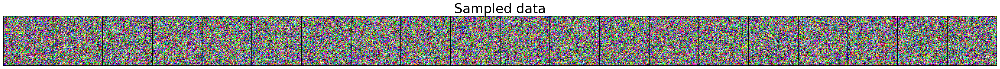

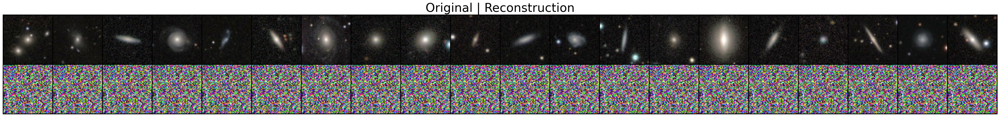

 2500/10000 [======>.......................] - ETA: 24:41 - elbo: 4268.2109 - iwlb: nan - kld: 44.0997 - ll: 4312.3120 - loss: -4268.2109 - x_mse: 0.0070 - elbo_test: 3873.9561 - iwlb_test: nan - kld_test: 43.3306 - ll_test: 3917.2866 - loss_test: -3873.9561 - x_mse_test: 0.0086231 - ETA: 72:46:43 - elbo: -6504.1313 - iwlb: nan - kld: 0.0370 - ll: -6504.0947 - loss: 6504.1313 - x_mse: 1.3144 - elbo_test: -6677.0947 - iwlb_test: nan - kld_test: 0.0141 - ll_test: -6677.0811 - loss_test: 6677.0947 - x_mse_test: 1.391 - ETA: 48:40:27 - elbo: -6340.6128 - iwlb: nan - kld: 0.0699 - ll: -6340.5430 - loss: 6340.6128 - x_mse: 1.2372 - elbo_test: -6677.0947 - iwlb_test: nan - kld_test: 0.0141 - ll_test: -6677.0811 - loss_test: 6677.0947 - x_mse_test: 1.39 - ETA: 36:37:20 - elbo: -6189.5273 - iwlb: nan - kld: 0.1221 - ll: -6189.4058 - loss: 6189.5273 - x_mse: 1.1647 - elbo_test: -6677.0947 - iwlb_test: nan - kld_test: 0.0141 - ll_test: -6677.0811 - loss_test: 6677.0947 - x_mse_test: 1.39 - ETA: 2

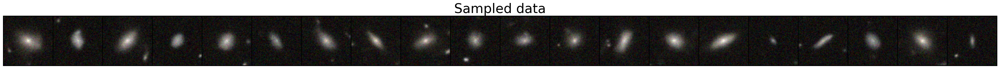

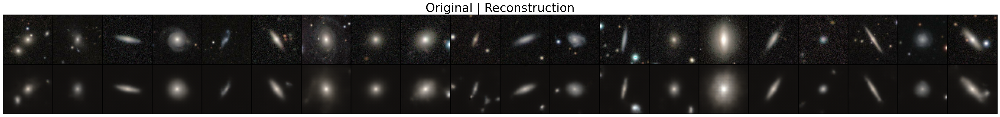

 5000/10000 [==============>...............] - ETA: 15:42 - elbo: 4735.8730 - iwlb: nan - kld: 50.3244 - ll: 4786.1968 - loss: -4735.8730 - x_mse: 0.0057 - elbo_test: 3470.5132 - iwlb_test: nan - kld_test: 51.0682 - ll_test: 3521.5811 - loss_test: -3470.5132 - x_mse_test: 0.0092- ETA: 24:57 - elbo: 4342.7422 - iwlb: nan - kld: 43.6264 - ll: 4386.3687 - loss: -4342.7422 - x_mse: 0.0068 - elbo_test: 3873.9561 - iwlb_test: nan - kld_test: 43.3306 - ll_test: 3917.2866 - loss_test: -3873.9561 - x_mse_test: 0.008 - ETA: 24:57 - elbo: 4352.8398 - iwlb: nan - kld: 43.8039 - ll: 4396.6440 - loss: -4352.8398 - x_mse: 0.0067 - elbo_test: 3873.9561 - iwlb_test: nan - kld_test: 43.3306 - ll_test: 3917.2866 - loss_test: -3873.9561 - x_mse_test: 0.008 - ETA: 24:56 - elbo: 4348.6313 - iwlb: nan - kld: 43.8682 - ll: 4392.5000 - loss: -4348.6313 - x_mse: 0.0067 - elbo_test: 3873.9561 - iwlb_test: nan - kld_test: 43.3306 - ll_test: 3917.2866 - loss_test: -3873.9561 - x_mse_test: 0.008 - ETA: 24:56 - elbo

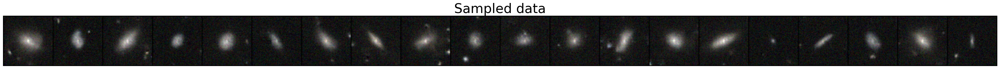

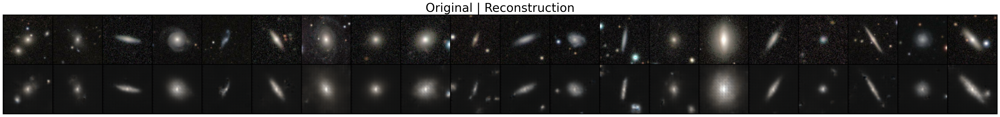

 7500/10000 [=====================>........] - ETA: 7:43 - elbo: 4876.4868 - iwlb: nan - kld: 53.7931 - ll: 4930.2793 - loss: -4876.4868 - x_mse: 0.0053 - elbo_test: 3367.9883 - iwlb_test: nan - kld_test: 53.3514 - ll_test: 3421.3396 - loss_test: -3367.9883 - x_mse_test: 0.00921- ETA: 15:47 - elbo: 4540.6494 - iwlb: nan - kld: 51.5113 - ll: 4592.1602 - loss: -4540.6494 - x_mse: 0.0062 - elbo_test: 3470.5132 - iwlb_test: nan - kld_test: 51.0682 - ll_test: 3521.5811 - loss_test: -3470.5132 - x_mse_test: 0.009 - ETA: 15:47 - elbo: 4565.6372 - iwlb: nan - kld: 51.1402 - ll: 4616.7769 - loss: -4565.6372 - x_mse: 0.0061 - elbo_test: 3470.5132 - iwlb_test: nan - kld_test: 51.0682 - ll_test: 3521.5811 - loss_test: -3470.5132 - x_mse_test: 0.009 - ETA: 15:47 - elbo: 4545.1748 - iwlb: nan - kld: 50.9454 - ll: 4596.1201 - loss: -4545.1748 - x_mse: 0.0062 - elbo_test: 3470.5132 - iwlb_test: nan - kld_test: 51.0682 - ll_test: 3521.5811 - loss_test: -3470.5132 - x_mse_test: 0.009 - ETA: 15:46 - elbo

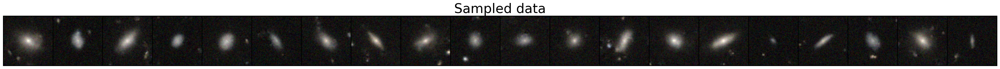

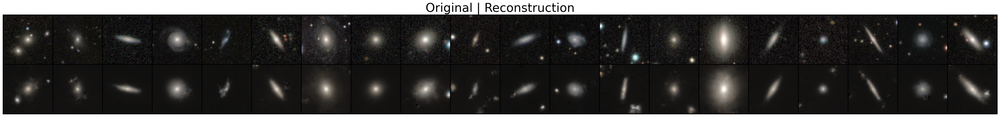

10000/10000 [==============================] - 1840s 184ms/step - elbo: 4931.7661 - iwlb: nan - kld: 55.7671 - ll: 4987.5337 - loss: -4931.7661 - x_mse: 0.0051 - elbo_test: 3272.6064 - iwlb_test: nan - kld_test: 55.3510 - ll_test: 3327.9578 - loss_test: -3272.6064 - x_mse_test: 0.0093:45 - elbo: 4836.9082 - iwlb: nan - kld: 53.6586 - ll: 4890.5664 - loss: -4836.9082 - x_mse: 0.0054 - elbo_test: 3367.9883 - iwlb_test: nan - kld_test: 53.3514 - ll_test: 3421.3396 - loss_test: -3367.9883 - x_mse_test: 0.00 - ETA: 7:44 - elbo: 4855.7563 - iwlb: nan - kld: 53.7831 - ll: 4909.5391 - loss: -4855.7563 - x_mse: 0.0053 - elbo_test: 3367.9883 - iwlb_test: nan - kld_test: 53.3514 - ll_test: 3421.3396 - loss_test: -3367.9883 - x_mse_test: 0.00 - ETA: 7:44 - elbo: 4871.7627 - iwlb: nan - kld: 53.7677 - ll: 4925.5298 - loss: -4871.7627 - x_mse: 0.0053 - elbo_test: 3367.9883 - iwlb_test: nan - kld_test: 53.3514 - ll_test: 3421.3396 - loss_test: -3367.9883 - x_mse_test: 0.00 - ETA: 7:44 - elbo: 4883.87

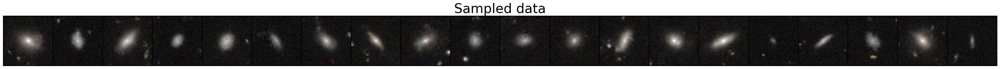

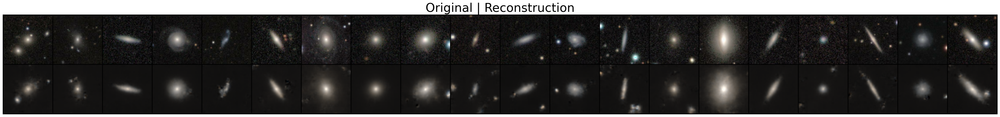

lr,▂▃▅▆██████▇▇▇▇▇▆▆▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁
train/elbo,▁▁▂▃▅▅▆▇▇▇██████████████████████████████
train/kld,▁▁▁▁▂▃▅▅▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇████████████████
train/ll,▁▁▂▃▅▅▆▇▇▇██████████████████████████████
train/loss,██▇▆▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train/x_mse,██▆▆▅▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
valid/elbo,▁▃▄▅▆▇▇█████████████████████████████████
valid/kld,▁▁▁▂▂▃▄▅▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇███████████████
valid/ll,▁▃▄▅▆▇▇█████████████████████████████████
valid/loss,█▆▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
valid/x_mse,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


In [8]:
run = wandb.init(
    project="iclr2024experiments",
    entity="invariance-learners",
    config=vae_config.to_dict(),
    mode="offline",
    notes="",
    name=None,
    settings=wandb.Settings(code_dir="../"),
)

final_vae_state, history, _ = ciclo.train_loop(
    vae_state,
    deterministic_data.start_input_pipeline(train_ds),
    {
        ciclo.on_train_step: [train_step],
        ciclo.every(int(vae_config.steps * vae_config.plot_freq)): [
            sampling_plot,
            reconstruction_plot,
        ],
        ciclo.on_reset_step: reset_metrics,
        ciclo.on_test_step: [
            eval_step,
        ],
        ciclo.every(1): custom_wandb_logger(run=run),
    },
    test_dataset=lambda: deterministic_data.start_input_pipeline(val_ds),
    epoch_duration=int(vae_config.steps * vae_config.eval_freq),
    callbacks=[
        ciclo.keras_bar(total=vae_config.steps),
    ],
    stop=vae_config.steps + 1,
)

run.finish()

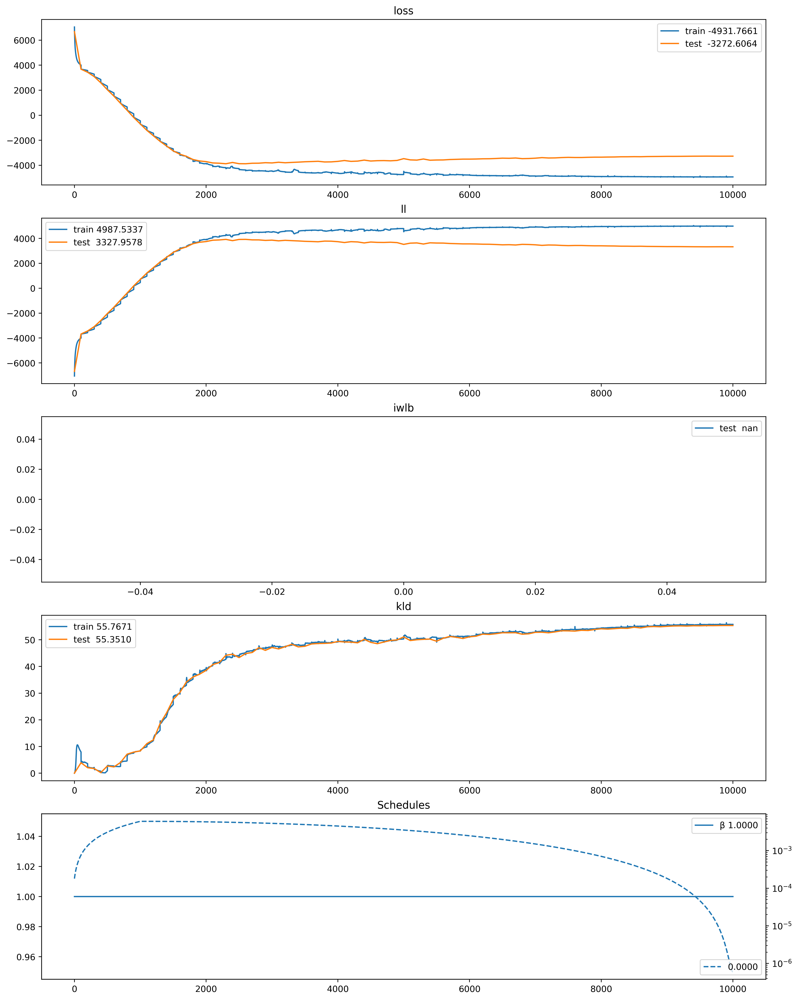

In [9]:
# plot the training history
steps, loss, elbo, ll, kld, lr, β = history.collect(
    "steps", "loss", "elbo", "ll", "kld", "lr", "β"
)
steps_test, loss_test, elbo_test, ll_test, kld_test, iwlb_test = history.collect(
    "steps", "loss_test", "elbo_test", "ll_test", "kld_test", "iwlb_test"
)

n_plots = 5
fig, axs = plt.subplots(n_plots, 1, figsize=(15, 4 * n_plots), dpi=400)

axs[0].plot(steps, loss, label=f"train {loss[-1]:.4f}")
axs[0].plot(steps_test, loss_test, label=f"test  {loss_test[-1]:.4f}")
axs[0].legend()
axs[0].set_title("loss")

axs[1].plot(steps, ll, label=f"train {ll[-1]:.4f}")
axs[1].plot(steps_test, ll_test, label=f"test  {ll_test[-1]:.4f}")
axs[1].legend()
axs[1].set_title("ll")

axs[2].plot(steps_test, iwlb_test, label=f"test  {iwlb_test[-1]:.4f}")
axs[2].legend()
axs[2].set_title("iwlb")

axs[3].plot(steps, kld, label=f"train {kld[-1]:.4f}")
axs[3].plot(steps_test, kld_test, label=f"test  {kld_test[-1]:.4f}")
axs[3].legend()
axs[3].set_title("kld")

axs[4].plot(steps, β, label=f"β {β[-1]:.4f}")
axs[4].legend()
axs[4].set_title("Schedules")

ax4_twin = axs[4].twinx()
ax4_twin.plot(steps, lr, "--", label=f"{lr[-1]:.4f}")
ax4_twin.legend(loc="lower right")
ax4_twin.set_yscale("log")

plt.show()

In [10]:
vae_config_test = vae_config.copy_and_resolve_references()
vae_config_test.run_iwlb = True
vae_config_test.test_split = "test"

_, _, test_ds = get_data(vae_config_test, data_rng)
_, test_step = make_vae_train_and_eval(vae_model, vae_config_test)

_, test_history, _ = ciclo.test_loop(
    final_vae_state,
    deterministic_data.start_input_pipeline(test_ds),
    {
        ciclo.on_reset_step: reset_metrics,
        ciclo.on_test_step: [
            test_step,
        ],
    },
)

INFO:absl:Load dataset info from /homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0


INFO:absl:Reusing dataset galaxy_mnist (/homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0)
INFO:absl:Constructing tf.data.Dataset galaxy_mnist for split _EvenSplit(split='train[1000:]', index=0, count=1, drop_remainder=False), from /homes/jua23/tensorflow_datasets/galaxy_mnist/1.0.0
INFO:absl:Features before preprocessing: {'image': 'uint8[None, None, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op ValueRange(vmin=-1, vmax=1, in_min=0, in_max=255.0, clip_values=False, key='image', key_result=None):
{'image': 'float32[None, None, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op Resize(resize_size=64, method='bilinear', key='image', key_result=None):
{'image': 'float32[64, 64, 3]', 'label': 'int64[]', 'rng': 'int32[2]'}
INFO:absl:Features after op Keep(keys=['image', 'label']):
{'image': 'float32[64, 64, 3]', 'label': 'int64[]'}
INFO:absl:Features after preprocessing: {'image': 'float32[64, 64, 3]', 'label': 'int64[]'}
INFO:absl:Constructi

XlaRuntimeError: UNKNOWN: Failed to determine best cudnn convolution algorithm for:
%cudnn-conv-bias-activation.64 = (f32[153600,256,16,16]{3,2,1,0}, u8[0]{0}) custom-call(f32[153600,3,16,16]{3,2,1,0} %transpose.18, f32[256,3,3,3]{3,2,1,0} %transpose.19, f32[256]{0} %Arg_1.2), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", metadata={op_name="jit(eval_step)/jit(main)/vmap(VAE.importance_weighted_lower_bound)/vmap(p_X_given_Z)/ConvTranspose_0/conv_general_dilated[window_strides=(1, 1) padding=((1, 1), (1, 1)) lhs_dilation=(1, 1) rhs_dilation=(1, 1) dimension_numbers=ConvDimensionNumbers(lhs_spec=(0, 3, 1, 2), rhs_spec=(3, 2, 0, 1), out_spec=(0, 3, 1, 2)) feature_group_count=1 batch_group_count=1 precision=None preferred_element_type=None]" source_file="/homes/jua23/.virtualenvs/inv/lib/python3.11/site-packages/flax/linen/linear.py" source_line=745}, backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0}

Original error: RESOURCE_EXHAUSTED: Out of memory while trying to allocate 40282095616 bytes.

To ignore this failure and try to use a fallback algorithm (which may have suboptimal performance), use XLA_FLAGS=--xla_gpu_strict_conv_algorithm_picker=false.  Please also file a bug for the root cause of failing autotuning.

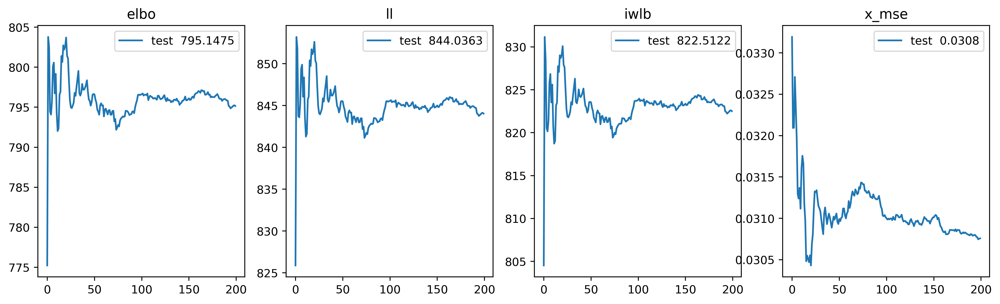

In [ ]:
# make a plot of the test history (specifically the ELBO, ll, iwlb)
steps, elbo, ll, iwlb, x_mse = test_history.collect("steps", "elbo", "ll", "iwlb", "x_mse")

fig, axs = plt.subplots(1, 4, figsize=(15, 4), dpi=400)

axs[0].plot(steps, elbo, label=f"test  {elbo[-1]:.4f}")
axs[0].legend()
axs[0].set_title("elbo")

axs[1].plot(steps, ll, label=f"test  {ll[-1]:.4f}")
axs[1].legend()
axs[1].set_title("ll")

axs[2].plot(steps, iwlb, label=f"test  {iwlb[-1]:.4f}")
axs[2].legend()
axs[2].set_title("iwlb")

axs[3].plot(steps, x_mse, label=f"test  {x_mse[-1]:.4f}")
axs[3].legend()
axs[3].set_title("x_mse")

plt.show()